# User Analytics in the Telecommunication Industry - Overview

by: Smegnsh Demelash

# Dataset Overview

Analyze opportunities for profitablity and give a recommendation on whether TellCo campany  is worth for buying or selling. 
A monthly of aggregated telecommunication dataset on xDR  is used and the dataset contains useful information about the customers & 
their activities on the network. The raw data contains 150001 rows and 55 columns.

# Research Questions:

1. What is avarage duration of customers?
2. What are 10 handsets used by the customers and the top 3 handset manufacturers?
3. What are the top 5 handsets per top 3 handset manufacturer?
4. Which applications(Social Media, Google, Email, Youtube, Netflix, Gaming, Other)are mostly used by customers?
5. What is the total data volume (in Bytes) (the total download (DL) and upload (UL) data) during each session for
   each application?





# Methdology

Python pandas liberary is basically used.
Here are some basic steps used for analysis:

    1. Data wrangling (gather, assess and clean the data, deal with missing value, store data)
    2. Exploring (try to answer research questions)
    3. Visualizing 


# Data wrangling

Load data

In [1]:
# import all packages and set plots to be embedded inline
import numpy as np
import pandas as pd
import statsmodels.api as sm
import seaborn as sb
import matplotlib.pyplot as plt       # Standard plotting library                 
from IPython.display import display   # A notebook function to display more complex data (like tables)
import scipy.stats as stats           # Scipy again


In [2]:
%matplotlib inline

# suppress warnings from final output
import warnings
warnings.simplefilter("ignore")

In [3]:
#read an excel file 
df = pd.read_excel(r'C:\Users\Smegn\Documents\GitHub\PythonPackageStructure\data\Week1_challenge_data_source.xlsx')
              

In [4]:
# set up to view all the info of the columns
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [5]:
df.sample(10)

,Bearer Id,Start,Start ms,End,End ms,Dur. (ms),IMSI,MSISDN/Number,IMEI,Last Location Name,Avg RTT DL (ms),Avg RTT UL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),TCP DL Retrans. Vol (Bytes),TCP UL Retrans. Vol (Bytes),DL TP < 50 Kbps (%),50 Kbps < DL TP < 250 Kbps (%),250 Kbps < DL TP < 1 Mbps (%),DL TP > 1 Mbps (%),UL TP < 10 Kbps (%),10 Kbps < UL TP < 50 Kbps (%),50 Kbps < UL TP < 300 Kbps (%),UL TP > 300 Kbps (%),HTTP DL (Bytes),HTTP UL (Bytes),Activity Duration DL (ms),Activity Duration UL (ms),Dur. (ms).1,Handset Manufacturer,Handset Type,Nb of sec with 125000B < Vol DL,Nb of sec with 1250B < Vol UL < 6250B,Nb of sec with 31250B < Vol DL < 125000B,Nb of sec with 37500B < Vol UL,Nb of sec with 6250B < Vol DL < 31250B,Nb of sec with 6250B < Vol UL < 37500B,Nb of sec with Vol DL < 6250B,Nb of sec with Vol UL < 1250B,Social Media DL (Bytes),Social Media UL (Bytes),Google DL (Bytes),Google UL (Bytes),Email DL (Bytes),Email UL (Bytes),Youtube DL (Bytes),Youtube UL (Bytes),Netflix DL (Bytes),Netflix UL (Bytes),Gaming DL (Bytes),Gaming UL (Bytes),Other DL (Bytes),Other UL (Bytes),Total UL (Bytes),Total DL (Bytes)
74839,13114483560348798976,2019-04-26 09:08:49,17.0,2019-04-27 12:55:46,27.0,100017.0,2.082099e+14,3.366402e+10,3.561421e+13,D73601B,35.0,4.0,23.0,40.0,NaN,NaN,100.0,0.0,0.0,0.0,100.0,0.0,0.0,0.0,NaN,NaN,2075.0,8852.0,100017010.0,Apple,Apple iPhone 6S (A1688),NaN,NaN,NaN,NaN,NaN,NaN,30.0,82.0,1893289.0,39594.0,1703485.0,1935475.0,2028056.0,355924.0,8512547.0,20271740.0,23133031.0,15997522.0,347079115.0,16556825.0,220227299.0,15574077.0,70731157.0,384349523.0
67852,7277825660652650496,2019-04-26 07:48:32,870.0,2019-04-27 03:27:20,407.0,70727.0,2.082015e+14,3.365881e+10,8.637690e+13,T94460B,76.0,20.0,37943.0,4000.0,147803952.0,395360.0,67.0,2.0,10.0,19.0,92.0,7.0,0.0,0.0,123199981.0,8317302.0,13570135.0,3112429.0,70727537.0,Huawei,Huawei B528S-23A,7193.0,2593.0,3753.0,3.0,973.0,7.0,24494.0,32249.0,3182148.0,24574.0,8692718.0,1427954.0,1367908.0,847178.0,18282927.0,169456.0,18463696.0,21986309.0,42169289.0,5807971.0,418916235.0,7370102.0,37633544.0,92158686.0
129783,7349883261804630016,2019-04-28 10:37:22,674.0,2019-04-30 08:41:17,249.0,165834.0,2.082015e+14,3.366234e+10,3.590391e+13,T12743B,NaN,NaN,56.0,52.0,NaN,NaN,100.0,0.0,0.0,0.0,100.0,0.0,0.0,0.0,NaN,NaN,10987.0,10551.0,165834575.0,Samsung,Samsung Galaxy S8 (Sm-G950F),NaN,NaN,NaN,NaN,NaN,NaN,58.0,58.0,2021945.0,4689.0,9579249.0,1305259.0,3530391.0,205290.0,19407269.0,8965864.0,3943996.0,5684542.0,442493990.0,397172.0,463619568.0,15978114.0,32540930.0,480976840.0
79993,13114483564931399680,2019-04-27 07:50:59,742.0,2019-04-28 00:13:06,487.0,58926.0,2.082009e+14,3.369869e+10,3.594941e+13,L72381A,50.0,4.0,43.0,50.0,NaN,1294.0,100.0,0.0,0.0,0.0,100.0,0.0,0.0,0.0,NaN,NaN,21790.0,27702.0,58926745.0,Apple,Apple iPhone 8 (A1905),NaN,NaN,NaN,NaN,NaN,NaN,91.0,97.0,1253802.0,50002.0,111352.0,4015890.0,202826.0,355607.0,16094123.0,19647089.0,19454190.0,20676932.0,366421262.0,174245.0,561757680.0,8275756.0,53195521.0,403537555.0
115474,13042425974562799616,2019-04-28 00:57:02,727.0,2019-04-29 00:18:07,914.0,84065.0,2.082018e+14,3.369986e+10,3.534681e+13,T79620B,43.0,7.0,5179.0,380.0,NaN,NaN,92.0,5.0,1.0,0.0,99.0,0.0,0.0,0.0,173684.0,25078.0,202913.0,155981.0,84065187.0,undefined,undefined,NaN,5.0,23.0,NaN,88.0,NaN,1368.0,1376.0,2850337.0,20332.0,4138091.0,3340513.0,2967881.0,555912.0,22178102.0,17654159.0,19394847.0,15410434.0,616283672.0,12662627.0,363807951.0,8923284.0,58567261.0,667812930.0
107872,7349883259316689920,2019-04-27 14:02:38,58.0,2019-04-29 08:53:49,911.0,154271.0,2.082021e+14,3.360904e+10,3.532701e+13,D10661B,25.0,2.0,41.0,54.0,NaN,NaN,100.0,0.0,0.0,0.0,100.0,0.0,0.0,0.0,NaN,NaN,35749.0,41770.0,154271853.0,Apple,Apple iPhone 6S (A1688),NaN,NaN,NaN,NaN,NaN,NaN,149.0,167.0,1773086.0,25868.0,9346060.0,769282.0,1562206.0,498473.0,3613205.0,2376927.0,5822316.0,1172572.0,146034734.0,4263360.0,61231106.0,7354015.0,16460497.0,168151607.0
14704,13042425959168899072,

In [6]:
# column names
df.columns.tolist()

['Bearer Id',
 'Start',
 'Start ms',
 'End',
 'End ms',
 'Dur. (ms)',
 'IMSI',
 'MSISDN/Number',
 'IMEI',
 'Last Location Name',
 'Avg RTT DL (ms)',
 'Avg RTT UL (ms)',
 'Avg Bearer TP DL (kbps)',
 'Avg Bearer TP UL (kbps)',
 'TCP DL Retrans. Vol (Bytes)',
 'TCP UL Retrans. Vol (Bytes)',
 'DL TP < 50 Kbps (%)',
 '50 Kbps < DL TP < 250 Kbps (%)',
 '250 Kbps < DL TP < 1 Mbps (%)',
 'DL TP > 1 Mbps (%)',
 'UL TP < 10 Kbps (%)',
 '10 Kbps < UL TP < 50 Kbps (%)',
 '50 Kbps < UL TP < 300 Kbps (%)',
 'UL TP > 300 Kbps (%)',
 'HTTP DL (Bytes)',
 'HTTP UL (Bytes)',
 'Activity Duration DL (ms)',
 'Activity Duration UL (ms)',
 'Dur. (ms).1',
 'Handset Manufacturer',
 'Handset Type',
 'Nb of sec with 125000B < Vol DL',
 'Nb of sec with 1250B < Vol UL < 6250B',
 'Nb of sec with 31250B < Vol DL < 125000B',
 'Nb of sec with 37500B < Vol UL',
 'Nb of sec with 6250B < Vol DL < 31250B',
 'Nb of sec with 6250B < Vol UL < 37500B',
 'Nb of sec with Vol DL < 6250B',
 'Nb of sec with Vol UL < 1250B',
 'Socia

In [7]:
# number of data points
print(f" There are {df.shape[0]} rows and {df.shape[1]} columns")

 There are 150001 rows and 55 columns


#Handling the missing value

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150001 entries, 0 to 150000
Data columns (total 55 columns):
 #   Column                                    Non-Null Count   Dtype         
---  ------                                    --------------   -----         
 0   Bearer Id                                 150001 non-null  object        
 1   Start                                     150000 non-null  datetime64[ns]
 2   Start ms                                  150000 non-null  float64       
 3   End                                       150000 non-null  datetime64[ns]
 4   End ms                                    150000 non-null  float64       
 5   Dur. (ms)                                 150000 non-null  float64       
 6   IMSI                                      149431 non-null  float64       
 7   MSISDN/Number                             148935 non-null  float64       
 8   IMEI                                      149429 non-null  float64       
 9   Last Location N

From the information above we see that some columns have missing values

In [9]:
#chack duplicates
df[df.duplicated()].shape[0]

0

In [10]:
# how many missing values exist or better still what is the % of missing values in the dataset?
def df_missing_percent(df):

    # Calculate total number of cells in dataframe
    df_cells = np.product(df.shape)

    # Count number of missing values per column
    df_missing = df.isnull().sum()

    # Calculate total number of missing values
    df_missing_num=df_missing.sum()

    # Calculate percentage of missing values
    print("The week 1 challenge  dataset contains", round(((df_missing_num/df_cells) * 100), 2), "%", "missing values.")

df_missing_percent(df)

The week 1 challenge  dataset contains 12.49 % missing values.


In [11]:
# see column(s) having missing values
df.isna().sum()

Bearer Id                                        0
Start                                            1
Start ms                                         1
End                                              1
End ms                                           1
Dur. (ms)                                        1
IMSI                                           570
MSISDN/Number                                 1066
IMEI                                           572
Last Location Name                            1153
Avg RTT DL (ms)                              27829
Avg RTT UL (ms)                              27812
Avg Bearer TP DL (kbps)                          1
Avg Bearer TP UL (kbps)                          1
TCP DL Retrans. Vol (Bytes)                  88146
TCP UL Retrans. Vol (Bytes)                  96649
DL TP < 50 Kbps (%)                            754
50 Kbps < DL TP < 250 Kbps (%)                 754
250 Kbps < DL TP < 1 Mbps (%)                  754
DL TP > 1 Mbps (%)             

Data looks most columns has missing values. so lets handle it

In [12]:
df_missing_percent(df["Dur. (ms)"])

The week 1 challenge  dataset contains 0.0 % missing values.


In [13]:
L=df.columns.tolist()
len(L) 
#missing value percent for each collumn
i=0
while i<55:
    print(df_missing_percent(df[L[i]]),L[i])
    i=i+1


The week 1 challenge  dataset contains 0.0 % missing values.
None Bearer Id
The week 1 challenge  dataset contains 0.0 % missing values.
None Start
The week 1 challenge  dataset contains 0.0 % missing values.
None Start ms
The week 1 challenge  dataset contains 0.0 % missing values.
None End
The week 1 challenge  dataset contains 0.0 % missing values.
None End ms
The week 1 challenge  dataset contains 0.0 % missing values.
None Dur. (ms)
The week 1 challenge  dataset contains 0.38 % missing values.
None IMSI
The week 1 challenge  dataset contains 0.71 % missing values.
None MSISDN/Number
The week 1 challenge  dataset contains 0.38 % missing values.
None IMEI
The week 1 challenge  dataset contains 0.77 % missing values.
None Last Location Name
The week 1 challenge  dataset contains 18.55 % missing values.
None Avg RTT DL (ms)
The week 1 challenge  dataset contains 18.54 % missing values.
None Avg RTT UL (ms)
The week 1 challenge  dataset contains 0.0 % missing values.
None Avg Bearer TP

Columns: MSISDN/Number,Last Location Name,TCP DL Retrans. Vol (Bytes),TCP UL Retrans. Vol (Bytes),UL TP < 10 Kbps (%),10 Kbps < UL TP < 50 Kbps (%)
50 Kbps < UL TP < 300 Kbps (%), UL TP > 300 Kbps (%),HTTP DL (Bytes),HTTP UL (Bytes),Nb of sec with 125000B < Vol DL,
Nb of sec with 1250B < Vol UL < 6250B, Nb of sec with 31250B < Vol DL < 125000B,Nb of sec with 37500B < Vol UL,Nb of sec with 6250B < Vol DL < 31250B
Nb of sec with 6250B < Vol UL < 37500B,Nb of sec with Vol UL < 1250
: has missing valuegreater than 50%, but from this all variable MSISDN/Number is usefull for our decission.

In [14]:
# drop columns with more than 50% missing values except MSISDN/Number
df_clean = df.drop(['Last Location Name','TCP DL Retrans. Vol (Bytes)','TCP UL Retrans. Vol (Bytes)','UL TP < 10 Kbps (%)',
                    '10 Kbps < UL TP < 50 Kbps (%)','50 Kbps < UL TP < 300 Kbps (%)','UL TP > 300 Kbps (%)','HTTP DL (Bytes)',
                    'HTTP UL (Bytes)','Nb of sec with 125000B < Vol DL', 'Nb of sec with 1250B < Vol UL < 6250B', 'Nb of sec with 31250B < Vol DL < 125000B','Nb of sec with 37500B < Vol UL','Nb of sec with 6250B < Vol DL < 31250B','Nb of sec with 6250B < Vol UL < 37500B','Nb of sec with Vol UL < 1250B'], axis=1)
df_clean.shape

(150001, 39)

In [15]:
#check skewness of dataset
df_clean.skew(axis = 0, skipna = True)

Start ms                            0.000968
End ms                             -0.001163
Dur. (ms)                           3.952609
IMSI                               41.045956
MSISDN/Number                     332.155856
IMEI                                1.071470
Avg RTT DL (ms)                    62.907828
Avg RTT UL (ms)                    28.457415
Avg Bearer TP DL (kbps)             2.589437
Avg Bearer TP UL (kbps)             4.503413
DL TP < 50 Kbps (%)                -2.297803
50 Kbps < DL TP < 250 Kbps (%)      3.271453
250 Kbps < DL TP < 1 Mbps (%)       4.566158
DL TP > 1 Mbps (%)                  5.370351
Activity Duration DL (ms)           5.872256
Activity Duration UL (ms)           7.382557
Dur. (ms).1                         3.952609
Nb of sec with Vol DL < 6250B       9.042166
Social Media DL (Bytes)            -0.002136
Social Media UL (Bytes)            -0.000359
Google DL (Bytes)                  -0.008092
Google UL (Bytes)                   0.002216
Email DL (

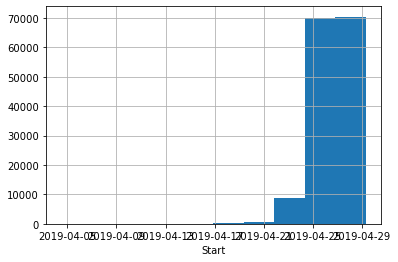

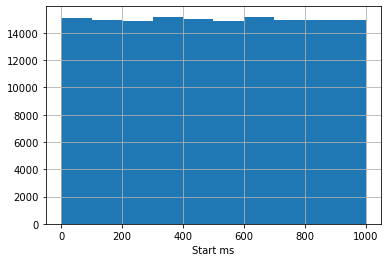

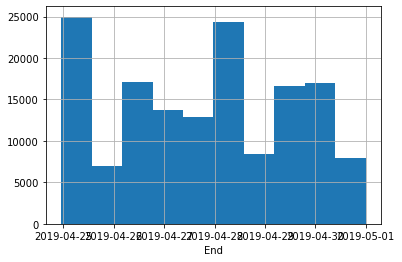

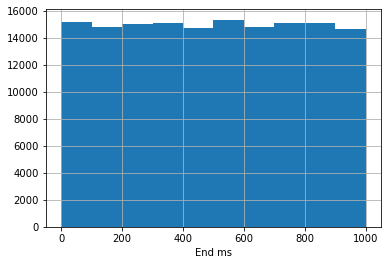

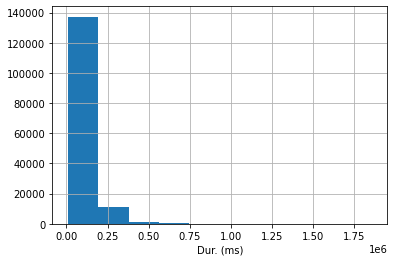

...

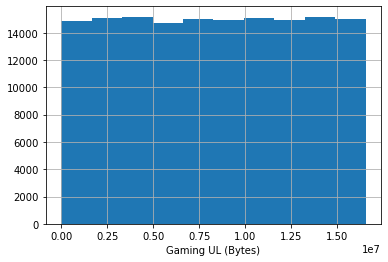

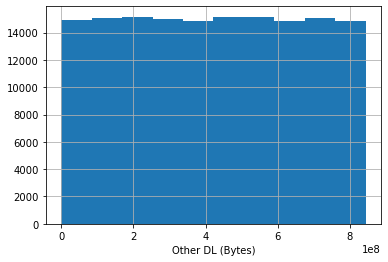

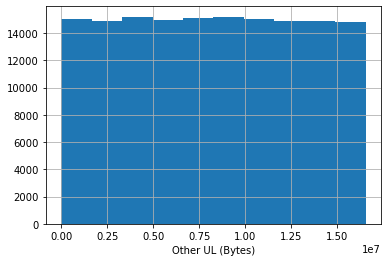

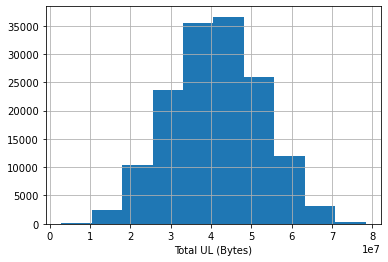

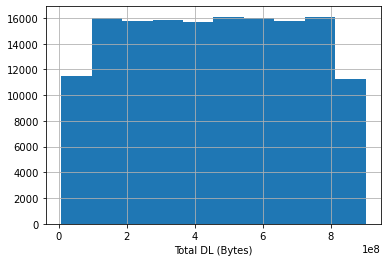

In [16]:
#checking for skewness graphically
numerical_features=[feature for feature in df_clean.columns if df_clean[feature].dtypes!='object']
for feature in numerical_features:
    if feature=='class(target)':
        pass
    else:
    
        
        df[feature].hist()
        plt.xlabel(feature)
        plt.show()

some of the data shows skewed and some are normally distributed so I choose to fill missing values using median

In [17]:
#fill missing value with median column value
df_clean.fillna(df_clean.median(),inplace=True)
#count the number of NAN values in each column
print(df_clean.isnull().sum())

Bearer Id                           0
Start                               1
Start ms                            0
End                                 1
End ms                              0
Dur. (ms)                           0
IMSI                                0
MSISDN/Number                       0
IMEI                                0
Avg RTT DL (ms)                     0
Avg RTT UL (ms)                     0
Avg Bearer TP DL (kbps)             0
Avg Bearer TP UL (kbps)             0
DL TP < 50 Kbps (%)                 0
50 Kbps < DL TP < 250 Kbps (%)      0
250 Kbps < DL TP < 1 Mbps (%)       0
DL TP > 1 Mbps (%)                  0
Activity Duration DL (ms)           0
Activity Duration UL (ms)           0
Dur. (ms).1                         0
Handset Manufacturer              572
Handset Type                      572
Nb of sec with Vol DL < 6250B       0
Social Media DL (Bytes)             0
Social Media UL (Bytes)             0
Google DL (Bytes)                   0
Google UL (B

In [21]:
df_missing_percent(df.fillna(df.median()))
df

The week 1 challenge  dataset contains 0.03 % missing values.


KeyboardInterrupt: 

In [22]:
# fill missing with ffill method for columns (diag_1, diag_2, diag_3)

def fix_missing_ffill(df_clean, col):
    df_clean[col] = df_clean[col].fillna(method='ffill')
    return df_clean[col]


def fix_missing_bfill(df_clean, col):
    df_clean[col] = df_clean[col].fillna(method='bfill')
    return df[col]

df_clean['Handset Manufacturer'] = fix_missing_ffill(df_clean, 'Handset Manufacturer')
df_clean['Handset Type'] = fix_missing_ffill(df_clean, 'Handset Type')
df_clean['Start'] = fix_missing_ffill(df_clean, 'Start')
df_clean['End'] = fix_missing_ffill(df_clean, 'End')



In [23]:
df_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150001 entries, 0 to 150000
Data columns (total 39 columns):
 #   Column                          Non-Null Count   Dtype         
---  ------                          --------------   -----         
 0   Bearer Id                       150001 non-null  object        
 1   Start                           150001 non-null  datetime64[ns]
 2   Start ms                        150001 non-null  float64       
 3   End                             150001 non-null  datetime64[ns]
 4   End ms                          150001 non-null  float64       
 5   Dur. (ms)                       150001 non-null  float64       
 6   IMSI                            150001 non-null  float64       
 7   MSISDN/Number                   150001 non-null  float64       
 8   IMEI                            150001 non-null  float64       
 9   Avg RTT DL (ms)                 150001 non-null  float64       
 10  Avg RTT UL (ms)                 150001 non-null  float64

In [26]:
#delate duplicate column
df_clean["Dur. (ms).1"]==df_clean["Dur. (ms)"]
del df_clean["Dur. (ms).1"]
    

In [27]:
df_clean.info()
df_clean.drop_duplicates(inplace=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150001 entries, 0 to 150000
Data columns (total 38 columns):
 #   Column                          Non-Null Count   Dtype         
---  ------                          --------------   -----         
 0   Bearer Id                       150001 non-null  object        
 1   Start                           150001 non-null  datetime64[ns]
 2   Start ms                        150001 non-null  float64       
 3   End                             150001 non-null  datetime64[ns]
 4   End ms                          150001 non-null  float64       
 5   Dur. (ms)                       150001 non-null  float64       
 6   IMSI                            150001 non-null  float64       
 7   MSISDN/Number                   150001 non-null  float64       
 8   IMEI                            150001 non-null  float64       
 9   Avg RTT DL (ms)                 150001 non-null  float64       
 10  Avg RTT UL (ms)                 150001 non-null  float64

# Transforming the data

Text(0.5, 1.0, 'Scaled data')

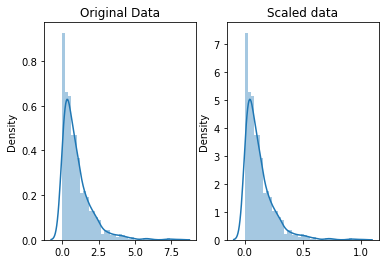

In [28]:
# generate 1000 data points randomly drawn from an exponential distribution
from mlxtend.preprocessing import minmax_scaling
original_data = np.random.exponential(size = 1000)
scaled_data = minmax_scaling(original_data, columns = [0])
# plot both together to compare
fig, ax=plt.subplots(1,2)
sb.distplot(original_data, ax=ax[0])
ax[0].set_title("Original Data")
sb.distplot(scaled_data, ax=ax[1])
ax[1].set_title("Scaled data")

In [29]:
#df_clean.sort_values(['Handset Type', 'Handset Manufacturer'], ascending=False).groupby('Handset Manufacturer').head(5)

# Exploration

In [30]:
# Function to calculate missing values by column
def missing_values_table(df):
    # Total missing values
    mis_val = df.isnull().sum()

    # Percentage of missing values
    mis_val_percent = 100 * df.isnull().sum() / len(df)

    # dtype of missing values
    mis_val_dtype = df.dtypes

    # Make a table with the results
    mis_val_table = pd.concat([mis_val, mis_val_percent, mis_val_dtype], axis=1)

    # Rename the columns
    mis_val_table_ren_columns = mis_val_table.rename(
    columns = {0 : 'Missing Values', 1 : '% of Total Values', 2: 'Dtype'})

    # Sort the table by percentage of missing descending
    mis_val_table_ren_columns = mis_val_table_ren_columns[
        mis_val_table_ren_columns.iloc[:,1] != 0].sort_values(
    '% of Total Values', ascending=False).round(1)

    # Print some summary information
    print ("Your selected dataframe has " + str(df.shape[1]) + " columns.\n"      
        "There are " + str(mis_val_table_ren_columns.shape[0]) +
          " columns that have missing values.")

    # Return the dataframe with missing information
    return mis_val_table_ren_columns

def format_float(value):
    return f'{value:,.2f}'
def data_aggr(df:pd.DataFrame, aggr_column:str, aggr_metric:str, col_name:str, top:int, order=False )->pd.DataFrame:
    
    new_df = df.groupby(aggr_column)[aggr_column].aggr(aggr_metric).reset_index(name=col_name).\
                        sort_values(by=col_name, ascending=order)[:top]
    
    return new_df
def convert_bytes_to_megabytes(df, bytes_data):
    """
        This function takes the dataframe and the column which has the bytes values
        returns the megabytesof that value
        
        Args:
        -----
        df: dataframe
        bytes_data: column with bytes values
        
        Returns:
        --------
        A series
    """
    
    megabyte = 1*10e+5
    df[bytes_data] = df[bytes_data] / megabyte
    return df[bytes_data]

def fix_outlier(df, column):
    df[column] = np.where(df[column] > df[column].quantile(0.95), df[column].median(),df[column])
    
    return df[column]
def plot_hist(df:pd.DataFrame, column:str, color:str)->None:
    # plt.figure(figsize=(15, 10))
    # fig, ax = plt.subplots(1, figsize=(12, 7))
    sb.displot(data=df, x=column, color=color, kde=True, height=7, aspect=2)
    plt.title(f'Distribution of {column}', size=20, fontweight='bold')
    plt.show()

def plot_count(df:pd.DataFrame, column:str) -> None:
    plt.figure(figsize=(12, 7))
    sb.countplot(data=df, x=column)
    plt.title(f'Distribution of {column}', size=20, fontweight='bold')
    plt.show()
    
def plot_bar(df:pd.DataFrame, x_col:str, y_col:str, title:str, xlabel:str, ylabel:str)->None:
    plt.figure(figsize=(12, 7))
    sns.barplot(data = df, x=x_col, y=y_col)
    plt.title(title, size=20)
    plt.xticks(rotation=75, fontsize=14)
    plt.yticks( fontsize=14)
    plt.xlabel(xlabel, fontsize=16)
    plt.ylabel(ylabel, fontsize=16)
    plt.show()

def plot_heatmap(df:pd.DataFrame, title:str, cbar=False)->None:
    plt.figure(figsize=(12, 7))
    sb.heatmap(df, annot=True, cmap='viridis', vmin=0, vmax=1, fmt='.2f', linewidths=.7, cbar=cbar )
    plt.title(title, size=18, fontweight='bold')
    plt.show()

def plot_box(df:pd.DataFrame, x_col:str, title:str) -> None:
    plt.figure(figsize=(12, 7))
    sb.boxplot(data = df, x=x_col)
    plt.title(title, size=20)
    plt.xticks(rotation=75, fontsize=14)
    plt.show()

def plot_box_multi(df:pd.DataFrame, x_col:str, y_col:str, title:str) -> None:
    plt.figure(figsize=(12, 7))
    sb.boxplot(data = df, x=x_col, y=y_col)
    plt.title(title, size=20)
    plt.xticks(rotation=75, fontsize=14)
    plt.yticks( fontsize=14)
    plt.show()

def plot_scatter(df: pd.DataFrame, x_col: str, y_col: str, title: str, hue: str, style: str) -> None:
    plt.figure(figsize=(12, 7))
    sb.scatterplot(data = df, x=x_col, y=y_col, hue=hue, style=style)
    plt.title(title, size=20)
    plt.xticks(fontsize=14)
    plt.yticks( fontsize=14)
    plt.show()


pd.options.display.float_format = format_float



In [31]:
original_data[0].min(), original_data[0].max()

(1.7377822174219146, 1.7377822174219146)

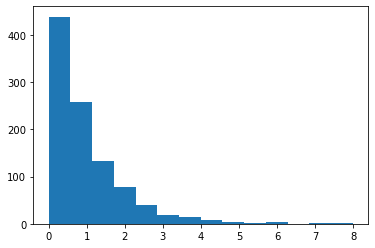

In [32]:
count, bins, ignored = plt.hist(original_data, 14)
plt.show()

In [33]:
missing_values_table(df_clean)

Your selected dataframe has 38 columns.
There are 0 columns that have missing values.


,Missing Values,% of Total Values,Dtype


In [34]:
df_Exp = df_clean.copy()
df_Exp.dtypes

Bearer Id                                 object
Start                             datetime64[ns]
Start ms                                 float64
End                               datetime64[ns]
End ms                                   float64
Dur. (ms)                                float64
IMSI                                     float64
MSISDN/Number                            float64
IMEI                                     float64
Avg RTT DL (ms)                          float64
Avg RTT UL (ms)                          float64
Avg Bearer TP DL (kbps)                  float64
Avg Bearer TP UL (kbps)                  float64
DL TP < 50 Kbps (%)                      float64
50 Kbps < DL TP < 250 Kbps (%)           float64
250 Kbps < DL TP < 1 Mbps (%)            float64
DL TP > 1 Mbps (%)                       float64
Activity Duration DL (ms)                float64
Activity Duration UL (ms)                float64
Handset Manufacturer                      object
Handset Type        

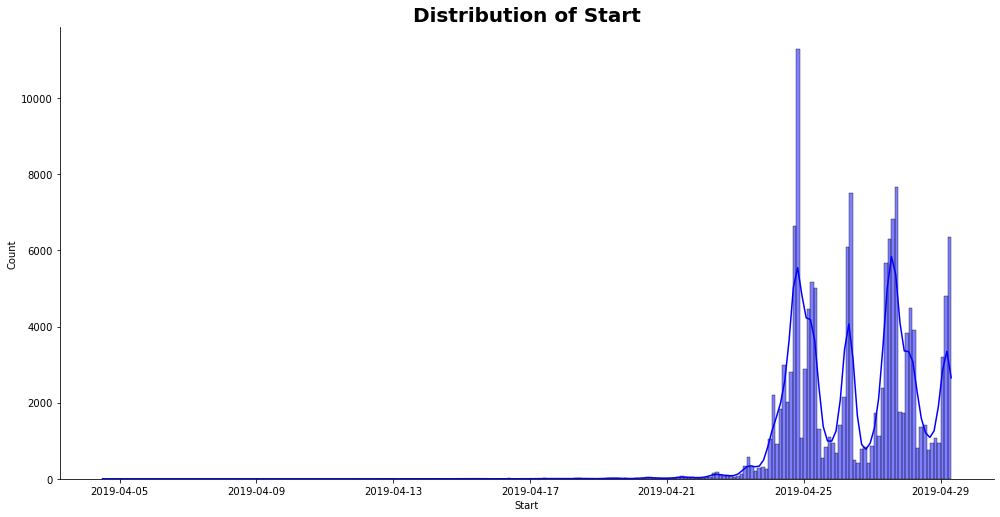

In [35]:
plot_hist(df_Exp, "Start", "blue")

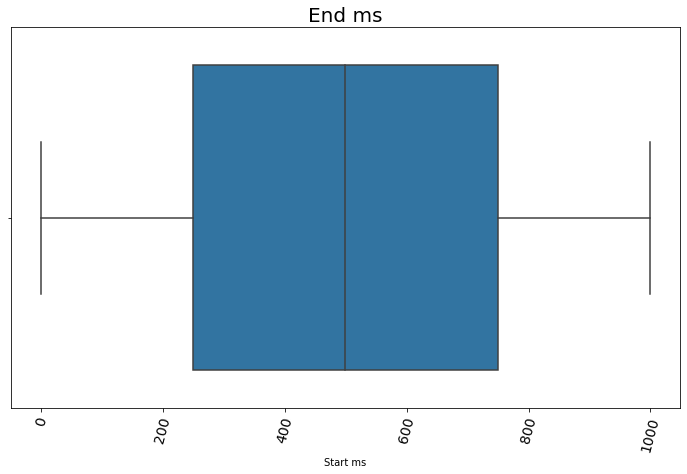

In [36]:
plot_box(df_Exp, "Start ms", "End ms")

In [37]:
#plot_count(df_Exp, "Dur. (ms)")

# Tasks

1.User Overview analysis 


In [38]:
#top 10 handsets used by the customers.
df_Exp["Handset Type"].describe(include='all')

count               150001
unique                1396
top       Huawei B528S-23A
freq                 19790
Name: Handset Type, dtype: object

In [39]:
df_Exp["Handset Manufacturer"].describe(include='all')

count     150001
unique       170
top        Apple
freq       59826
Name: Handset Manufacturer, dtype: object

In [40]:
x=df_Exp.sort_values(by='Handset Type',ascending=True)
x[0:9]

,Bearer Id,Start,Start ms,End,End ms,Dur. (ms),IMSI,MSISDN/Number,IMEI,Avg RTT DL (ms),Avg RTT UL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),DL TP < 50 Kbps (%),50 Kbps < DL TP < 250 Kbps (%),250 Kbps < DL TP < 1 Mbps (%),DL TP > 1 Mbps (%),Activity Duration DL (ms),Activity Duration UL (ms),Handset Manufacturer,Handset Type,Nb of sec with Vol DL < 6250B,Social Media DL (Bytes),Social Media UL (Bytes),Google DL (Bytes),Google UL (Bytes),Email DL (Bytes),Email UL (Bytes),Youtube DL (Bytes),Youtube UL (Bytes),Netflix DL (Bytes),Netflix UL (Bytes),Gaming DL (Bytes),Gaming UL (Bytes),Other DL (Bytes),Other UL (Bytes),Total UL (Bytes),Total DL (Bytes)
22915,13042425959482800128,2019-04-24 20:40:39,420.00,2019-04-25 00:01:42,627.00,"12,063.00","208,201,545,792,167.00","33,770,020,179.00","35,235,310,003,161.00",40.00,2.00,"23,184.00",326.00,83.00,4.00,0.00,10.00,"95,729.00","66,941.00",A-Link Telecom International Co Limited,A-Link Telecom I. Cubot A5,251.00,"2,030,805.00","59,037.00","2,539,979.00","3,649,106.00","1,359,786.00","714,285.00","17,374,335.00","6,877,932.00","7,988,067.00","12,427,656.00","600,724,410.00","16,082,125.00","75,565,047.00","3,496,126.00","43,306,267.00","632,017,382.00"
24538,6917537685937590272,2019-04-24 20:59:17,908.00,2019-04-25 01:58:22,147.00,"17,944.00","208,209,850,765,119.00","33,667,275,669.00","35,274,109,154,620.00","1,581.00",8.00,"6,527.00",172.00,93.00,4.00,2.00,0.00,"441,439.00","623,095.00",A-Link Telecom International Co Limited,A-Link Telecom I. Cubot Note Plus,744.00,"1,876,537.00","47,524.00","3,470,492.00","216,048.00","1,194,491.00","401,896.00","2,751,984.00","15,442,233.00","11,115,039.00","15,905,321.00","808,982,512.00","10,063,015.00","526,409,751.00","7,304,072.00","49,380,109.00","829,391,055.00"
83394,6917537694468679680,2019-04-27 10:27:01,402.00,2019-04-28 00:34:01,169.00,"50,819.00","208,200,314,696,306.00","33,641,064,789.00","35,748,207,009,491.00",886.00,4.00,"8,515.00",422.00,56.00,18.00,21.00,3.00,"4,099,155.00","380,153.00",A-Link Telecom International Co Limited,A-Link Telecom I. Cubot Note S,"6,614.00","1,963,592.00","10,145.00","10,676,660.00","2,213,550.00","1,395,014.00","182,173.00","22,050,742.00","16,395,992.00","17,912,540.00","186,123.00","758,495,114.00","12,779,284.00","469,053,998.00","11,369,112.00","43,136,379.00","812,493,662.00"
98614,13042425972970399744,2019-04-27 17:10:30,126.00,2019-04-28 01:36:29,683.00,"30,359.00","208,201,402,186,172.00","33,623,571,539.00","35,807,009,007,776.00",40.00,4.00,"55,667.00",550.00,78.00,10.00,4.00,5.00,"325,420.00","294,128.00",A-Link Telecom International Co Limited,A-Link Telecom I. Cubot Nova,523.00,"457,482.00","52,607.00","6,668,210.00","2,450,926.00","3,094,504.00","819,328.00","5,958,109.00","10,880,189.00","12,021,110.00","20,510,754.00","186,180,827.00","365,321.00","427,912,779.00","3,830,423.00","38,909,548.00","214,380,242.00"
24450,13042425959666399232,2019-04-24 20:58:22,423.00,2019-04-25 00:01:36,89.00,"10,993.00","208,200,314,555,169.00","33,678,329,905.00","35,807,109,013,012.00",39.00,4.00,"69,126.00",342.00,83.00,6.00,2.00,7.00,"139,161.00","130,168.00",A-Link Telecom International Co Limited,A-Link Telecom I. Cubot Power,533.00,"2,841,724.00","33,156.00","5,603,020.00","231,203.00","1,718,260.00","95,863.00","17,339,896.00","4,941,266.00","6,489,989.00","5,126,767.00","70,999,119.00","1,692,337.00","184,245,388.00","5,520,899.00","17,641,491.00","104,992,008.00"
113630,6917537696638550016,2019-04-27 23:47:49,544.00,2019-04-28 23:47:34,267.00,"86,384.00","208,200,314,265,290.00","33,760,421,033.00","35,958,408,130,069.00",192.00,39.00,"2,862.00","1,177.00",97.00,2.00,0.00,0.00,"418,901.00","441,955.00",A-Link Telecom International Co Limited,A-Link Telecom I. Cubot R9,"2,660.00","1,835,078.00","52,021.00","770,652.00","3,641,846.00","1,014,083.00","297,762.00","21,055,189.00","20,533,424.00","20,769,754.00","15,031,706.00","183,472,745.00","7,977,763.00","231,311,117.00","10,168,379.0

In [42]:
df_Exp.sort_values('Handset Type', ascending=False).head(-1)

KeyboardInterrupt: 

In [43]:
#df = df_Exp.groupby('Handset Type').apply(lambda x: x.value_counts().index[0]).reset_index()
#print (df)
df_1 = df_Exp.groupby('Handset Manufacturer')['Handset Type'].apply(lambda x: x.value_counts().index[0]).reset_index()
#res = df_Exp[df_Exp['Handset Manufacturer'] == modes].drop_duplicates()
print (df_1)
# there are 170 handset manufacturer and frequent manufacturer is apple


                                  Handset Manufacturer  \
0              A-Link Telecom International Co Limited   
1                                              ASUSTeK   
2                                                 Acer   
3                                                 Adar   
4                                  Alif Communications   
5                                                Apple   
6                                            Archos SA   
7                                            Archos Sa   
8                                              Asustek   
9                                       Avenir Telecom   
10                    Beijing Shenqi Technology Co Ltd   
11                                                Bird   
12                                    Blu Products Inc   
13                               Bullitt Group Limited   
14                    Casper Bilgisayar Sistemleri A.S   
15                             China Trade Group S.A.S   
16        Cisc

In [44]:
pd.Series(df_Exp['Handset Type'])

0                                Samsung Galaxy A5 Sm-A520F
1                               Samsung Galaxy J5 (Sm-J530)
2                                  Samsung Galaxy A8 (2018)
3                                                 undefined
4                                          Samsung Sm-G390F
5                                                 undefined
6                                       Huawei Mate 20 Lite
7                                                 undefined
8                                  Samsung Galaxy A8 (2018)
9                       Samsung Galaxy Note 8 (Sm-N950F Ds)
10                                                undefined
11                                          Huawei B593S-22
12                               Samsung Galaxy A5 Sm-A520F
13                      Samsung Galaxy Note 8 (Sm-N950F Ds)
14                      Samsung Galaxy Note 8 (Sm-N950F Ds)
15                              Samsung Galaxy J3 (Sm-J330)
16                              Samsung 

In [45]:
# top 10 handset types used by customer 
((df_Exp['Handset Type'].value_counts()/df_Exp['Handset Type'].count())*100)[:11]

Huawei B528S-23A               13.19
Apple iPhone 6S (A1688)         6.30
Apple iPhone 6 (A1586)          6.04
undefined                       6.01
Apple iPhone 7 (A1778)          4.24
Apple iPhone Se (A1723)         3.47
Apple iPhone 8 (A1905)          3.35
Apple iPhone Xr (A2105)         3.06
Samsung Galaxy S8 (Sm-G950F)    3.03
Apple iPhone X (A1901)          2.55
Samsung Galaxy A5 Sm-A520F      2.49
Name: Handset Type, dtype: float64

In [46]:
#top 3 handset manufacturers
TopThree=((df_Exp['Handset Manufacturer'].value_counts()/df_Exp['Handset Manufacturer'].count())*100)[:4]
TopThree

Apple       39.88
Samsung     27.32
Huawei      23.02
undefined    6.01
Name: Handset Manufacturer, dtype: float64

In [47]:
# the top 5 handsets per top 3 handset manufacturer
((df_Exp['Handset Type'].value_counts()/df_Exp['Handset Manufacturer'].count())*100)[:5]

Huawei B528S-23A          13.19
Apple iPhone 6S (A1688)    6.30
Apple iPhone 6 (A1586)     6.04
undefined                  6.01
Apple iPhone 7 (A1778)     4.24
Name: Handset Type, dtype: float64

In [48]:
#Aggregate per user 
#I use groupby() function to split the data into groups based on MSISDN/Number
df_Exp.groupby("MSISDN/Number")

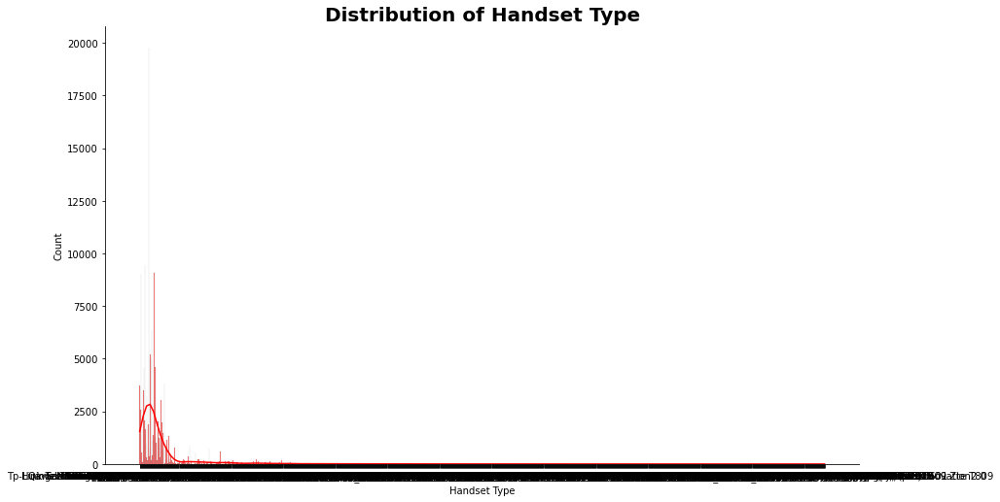

In [76]:
plot_hist(df_Exp, "Handset Type", "red")

In [49]:
#sum values
df_Exp.groupby("MSISDN/Number").sum()

KeyboardInterrupt: 

In [50]:
#max and min sesion start
column = df_Exp["Start"]
max_value = column.max()
min_value = column.min()

print(max_value,min_value)

2019-04-29 07:28:43 2019-04-04 12:01:18


In [51]:
k=(max_value-min_value)/3
k

Timedelta('8 days 06:29:08.333333333')

In [52]:
#aggregate total ul and dl using MSISDN/Number
df_group1=df_Exp.groupby("MSISDN/Number", as_index=True)[['Total UL (Bytes)', 'Total DL (Bytes)','Dur. (ms)']].mean()
#max and min total uploads
column = df_group1["Total UL (Bytes)"]
max_value = column.max()
min_value = column.min()

In [53]:
print(max_value,min_value)
#max and min total downloads
column1 = df_group1["Total DL (Bytes)"]
max_value = column1.max()
min_value = column1.min()

print(max_value,min_value)
#max and min total uploads
column = df_group1["Dur. (ms)"]
max_value = column.max()
min_value = column.min()
print(max_value,min_value)

78331311.0 2866892.0
902969616.0 8827082.0
1573420.0 7142.0


In [55]:
df_group1

,Total UL (Bytes),Total DL (Bytes),Dur. (ms)
MSISDN/Number,,,
"33,601,001,722.00","36,053,108.00","842,637,466.00","116,720.00"
"33,601,001,754.00","36,104,459.00","120,755,184.00","181,230.00"
"33,601,002,511.00","39,306,820.00","556,659,663.00","134,969.00"
"33,601,007,832.00","20,327,526.00","401,993,172.00","49,878.00"
"33,601,008,617.00","47,140,263.50","681,565,208.50","18,552.00"
"33,601,010,682.00","30,004,624.50","277,603,986.00","126,991.50"
"33,601,011,634.00","50,840,929.00","276,520,604.00","64,180.00"
"33,601,011,959.00","38,575,279.00","294,085,078.00","86,399.00"
"33,601,014,694.00","46,786,008.00","448,280,086.50","247,851.00"


In [56]:
df_group1["Total UL (Bytes)"].describe()

count      106,856.00
mean    41,127,001.35
std     10,386,614.18
min      2,866,892.00
25%     34,197,060.00
50%     41,127,014.58
75%     48,079,866.38
max     78,331,311.00
Name: Total UL (Bytes), dtype: float64

In [57]:
df_group1["Total DL (Bytes)"].describe()

count       106,856.00
mean    455,187,201.15
std     224,788,902.41
min       8,827,082.00
25%     276,273,292.25
50%     456,247,119.00
75%     633,812,078.38
max     902,969,616.00
Name: Total DL (Bytes), dtype: float64

In [58]:
#give descriptive analysis
df_group1["Dur. (ms)"].describe()

count     106,856.00
mean      102,694.33
std        72,247.42
min         7,142.00
25%        56,409.75
50%        86,400.00
75%       133,912.12
max     1,573,420.00
Name: Dur. (ms), dtype: float64

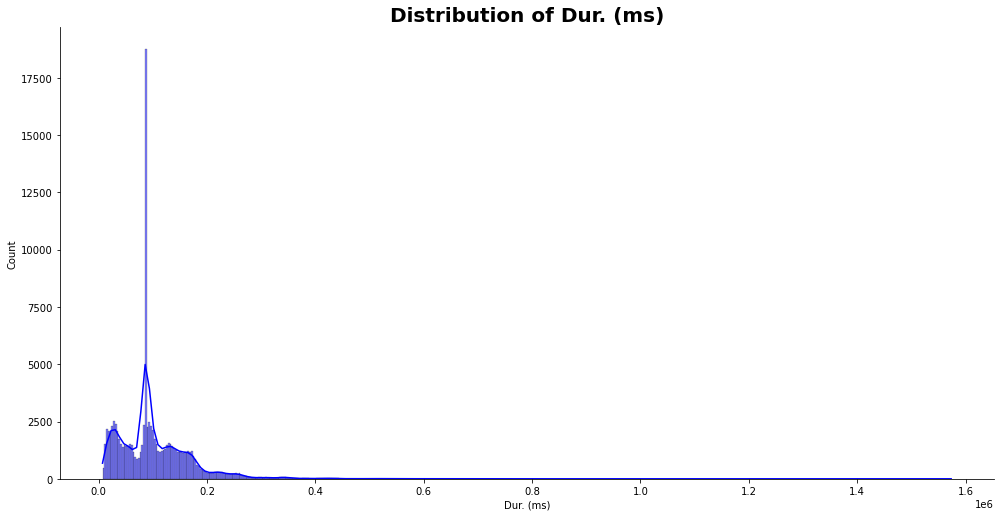

In [59]:
#plot distribution
plot_hist(df_group1, "Dur. (ms)", "blue")

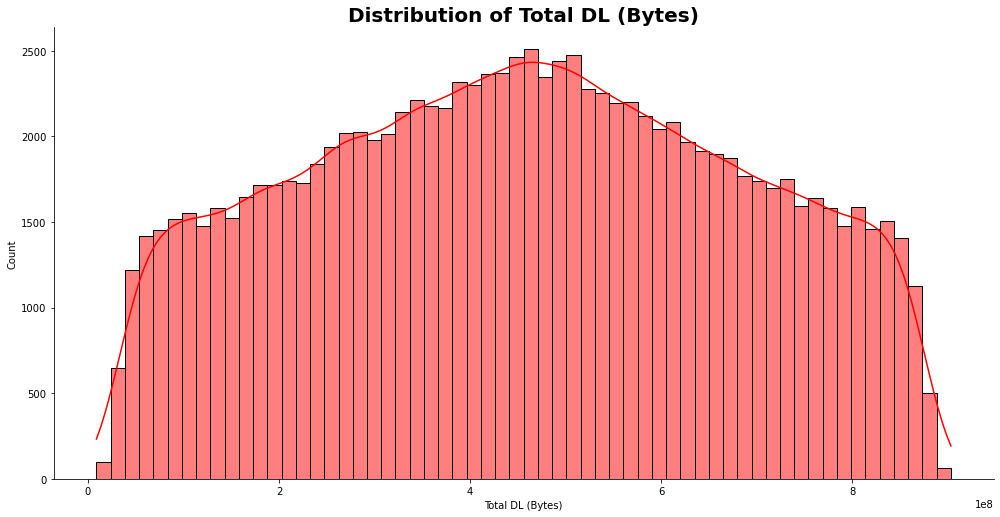

In [60]:
plot_hist(df_group1, "Total DL (Bytes)", "red")

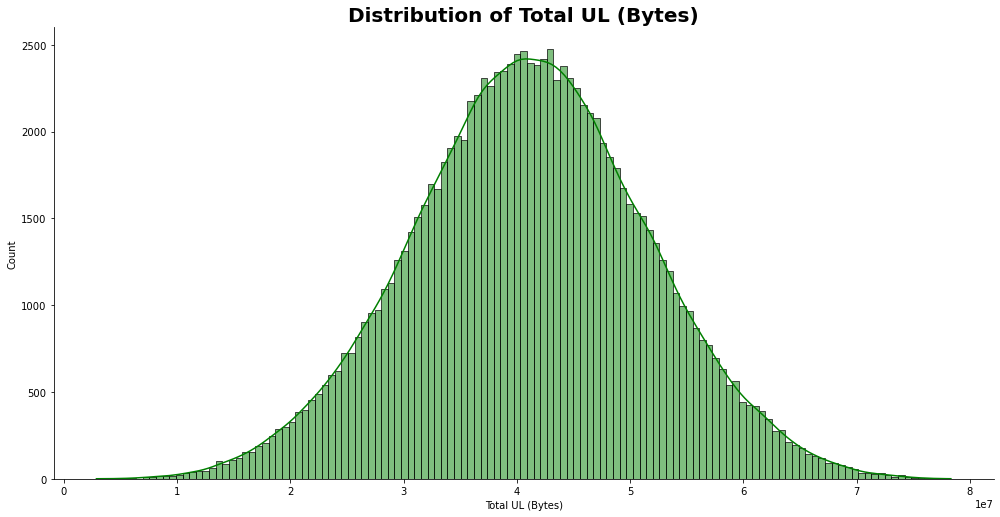

In [61]:
plot_hist(df_group1, "Total UL (Bytes)", "green")

# Interpretation of the destribution

From the plots we can understand that among each customers some of them wait a long time once they start using the app. And most of them are medium users that is they are in between.
Also once they are start using the app, the total uploads and downloads for each user is uniformlly distributed.

# multivarate analysis

In [ ]:
# determining the name of the file
file_name = 'clean_Data.csv'
  
# saving the excel
df_Exp.to_excel(file_name)
print('DataFrame is written to Excel File successfully.')

In [71]:
df_Exp.to_csv('C:/Users/Smegn/Documents/GitHub/PythonPackageStructure/data/clean_Data.csv')

In [74]:
pd.read_csv(r'C:\Users\Smegn\Documents\GitHub\PythonPackageStructure\data\clean_Data.csv')

KeyboardInterrupt: 